In [1]:
import pandas as pd
import os
from datetime import datetime 
import re
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler, MaxAbsScaler,RobustScaler,MinMaxScaler

def extract_units():
    fetch_log="../log/data_entire_fetch.log"
    with open(fetch_log,'r') as f:
        units = set()
        while True:
            line = f.readline()
            if line.startswith("[INFO] Started to"):
                pass
            else:
                break
            p = re.compile("[A-Z0-9]+/([A-Z0-9]+)")
            patterns =p.search(line)
            unit = patterns.groups()[0]
            units.add(unit)
        return units


In [2]:
def df_gen():
    path = "../data_close/"
    file_list = os.listdir(path)
    for file in file_list:
        df_dict = dict()

        df=pd.read_csv(path+file,header=None,index_col=0,names=['close'])
        symbol_c = file.split('_')[1]

        for unit in extract_units():
            if symbol_c.endswith(unit):
                symbol = "{}/{}".format(symbol_c[:-len(unit)],unit)
                break
        yield [symbol,df]


In [3]:
def standard_transform(data):
    ss_scaler = StandardScaler()
    ss_scaler.fit(data)
    return ss_scaler.transform(data)

def minmax_transform(data):
    ss_scaler = MinMaxScaler()
    ss_scaler.fit(data)
    return ss_scaler.transform(data)

def maxabs_transform(data):
    ss_scaler = MaxAbsScaler()
    ss_scaler.fit(data)
    return ss_scaler.transform(data)

def robust_transform(data):
    ss_scaler = RobustScaler()
    ss_scaler.fit(data)
    return ss_scaler.transform(data)

def create_scaled_df(df):
    data=df.copy(deep=True)
    df['standard']=minmax_transform(data)
    df['minmax']=standard_transform(data)
    df['maxabs']=maxabs_transform(data)
    df['robust']=robust_transform(data)
    
def create_sm_scaled_df(df):
    data=df.copy(deep=True)
    df['standard']=standard_transform(data)
    df['minmax']=minmax_transform(data)
    df['standard->minmax']=minmax_transform(df[['standard']])
    df['minmax->standard']=standard_transform(df[['minmax']])

In [6]:
row,col = 22, 5
fig,axs = plt.subplots(row,col,figsize=(60,220))
color_list=['b','g','c','m','y',]
df_g=df_gen()
for j in range(row):
    df=next(df_g)
    create_scaled_df(df[1])
    df.to_csv
    for i, method in enumerate(df[1].columns):
        axs[j,i].plot(df[1][method].values,color=color_list[i])
        axs[j,i].set_title(method)
        axs[j,0].set_ylabel(df[0])

fig.suptitle('Data Pre-processing (MarketCap)',x=0.5,y=1,fontsize=15)
fig.tight_layout()
plt.savefig("Data_scale.png")

In [4]:
row,col = 22, 4
fig,axs = plt.subplots(row,col,figsize=(60,220))
color_list=['b','g','c','m','y',]
df_g=df_gen()
for j in range(row):
    df=next(df_g)
    create_sm_scaled_df(df[1])
    for i, method in enumerate(df[1].columns):
        if i==0:
            axs[j,i].set_ylabel(df[0])
            axs[j,i].set_title(method)
        if '->' in method:
            axs[j,col-1].plot(df[1][method].values,color=color_list[i])
            axs[j,col-1].legend(['Standard->MinMax','MinMax->Standard'])
        else:
            axs[j,i].plot(df[1][method].values,color=color_list[i])

fig.suptitle('Data Pre-processing Satandard->MinMax, MinMax->Standard(MarketCap)',x=0.5,y=1,fontsize=15)
fig.tight_layout()
plt.savefig("Data_scale_smms.png")

In [10]:
df[1]

,close,standard,minmax,standard->minmax,minmax->standard
1593561600000,41.10,-1.389753,0.001625,0.001625,-1.389753
1593565200000,41.11,-1.389603,0.001652,0.001652,-1.389603
1593568800000,41.17,-1.388699,0.001814,0.001814,-1.388699
1593572400000,41.30,-1.386741,0.002166,0.002166,-1.386741
1593576000000,41.40,-1.385235,0.002437,0.002437,-1.385235
...,...,...,...,...,...
1656615600000,51.46,-1.233718,0.029675,0.029675,-1.233718
1656619200000,50.98,-1.240947,0.028375,0.028375,-1.240947
1656622800000,51.38,-1.234923,0.029458,0.029458,-1.234923
1656626400000,51.76,-1.229199,0.030487,0.030487,-1.229199


In [11]:
df_g=df_gen()
for j in range(22):
    df=next(df_g)
    create_sm_scaled_df(df[1])
    df[1].to_csv("../data_scale/BINANCE_%s_1h_SCALED.csv"%(df[0].replace('/','')))


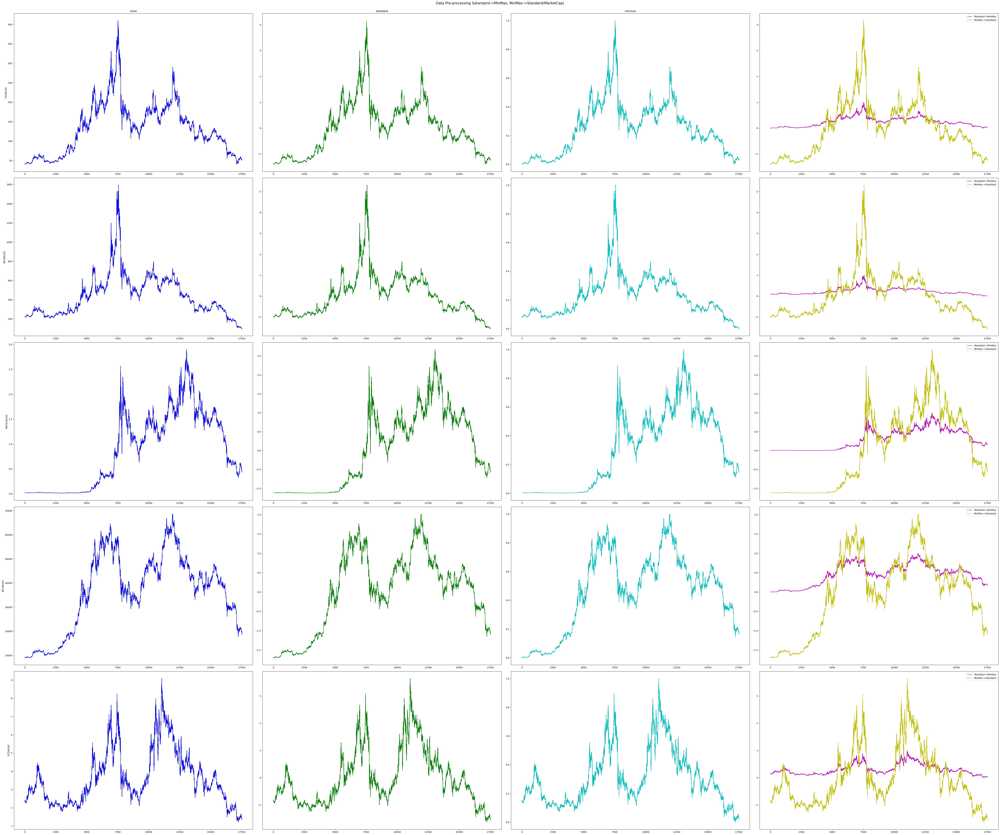

In [11]:
row,col = 5, 4
fig,axs = plt.subplots(row,col,figsize=(60,50))
color_list=['b','g','c','m','y',]
df_g=df_gen()
for j in range(row):
    if j==5:
        break
    df=next(df_g)
    create_sm_scaled_df(df[1])

    axs[j,0].set_ylabel(df[0])
    axs[0,0].set_title("close")
    axs[0,1].set_title("standard")
    axs[0,2].set_title("minmax")

    axs[j,0].plot(df[1]["close"].values,color=color_list[0])
    axs[j,1].plot(df[1]["standard"].values,color=color_list[1])
    axs[j,2].plot(df[1]["minmax"].values,color=color_list[2])
    axs[j,3].plot(df[1]["standard->minmax"].values,color=color_list[3])
    axs[j,3].plot(df[1]["minmax->standard"].values,color=color_list[4])
    axs[j,3].legend(['Standard->MinMax','MinMax->Standard'])


fig.suptitle('Data Pre-processing Satandard->MinMax, MinMax->Standard(MarketCap)',x=0.5,y=1,fontsize=15)
fig.tight_layout()
plt.savefig("Data_scale_smms_1.png")